## Project: Advanced Lane Finding
------------------------------------------------

## 1. Camera Calibration

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os

objPoints = []
imgPoints = []

cameraMtx = None
distCoeff = None

In [2]:
# loop through calibration images, apply transform and display output
def tryCalibrationImages(func, label):
    fg, ax = plt.subplots(10, 4, figsize=(20, 30))
    ax = ax.ravel()
    i = 0

    for file in os.listdir('camera_cal/'):
        # read image from file
        img = cv2.imread('camera_cal/'+file)

        # apply transformation
        imgOut = func(img)
    
        # display original image
        ax[i].axis('off')
        ax[i].imshow(img)
        ax[i].set_title(file)
        i = i + 1

        # display transformed image
        ax[i].axis('off')
        ax[i].imshow(imgOut)
        ax[i].set_title(label)
        i = i + 1

### 1.1. Find Chessboard Corners and Calibrate Camera

In [3]:
# find chessboard corners and populate objpoints and imgpoints
def chessboardCorner(img):
    global objPoints
    global imgPoints
    
    nx = 9
    ny = 6

    objp = np.zeros((ny*nx, 3), np.float32)
    objp[:,:2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)
    
    # convert to grayscale and find chessboard corners
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

    imgOut = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    if ret == True:
        # save image points and object points for mapping from 2D world to 3D world
        imgPoints.append(corners)
        objPoints.append(objp)
        
        # highlight found chessboard corners
        cv2.drawChessboardCorners(imgOut, (nx, ny), corners, ret)

    return imgOut

In [4]:
# calibrate camera
def calibrateCamera(objpoints, imgpoints):
    # find shape of image
    img = cv2.imread('camera_cal/calibration1.jpg')
    print("image shape (x, y) :", img.shape[1::-1])

    # calibrate camera
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img.shape[1::-1], None, None)
    
    return mtx, dist

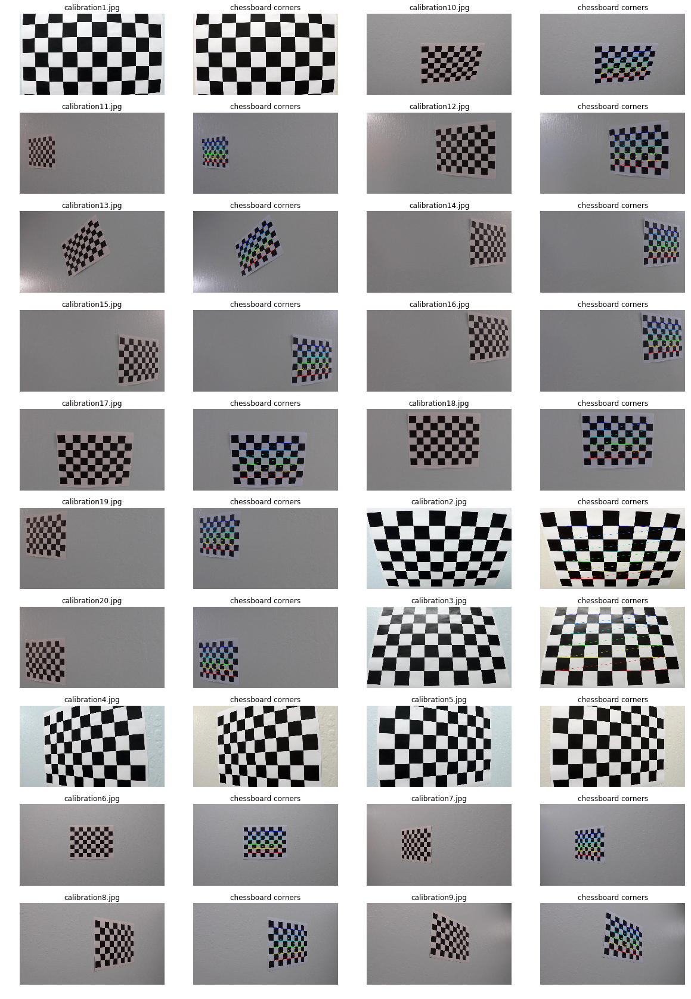

In [5]:
# find chessboard corners and display output
tryCalibrationImages(chessboardCorner, 'chessboard corners')

### 1.2. Calculate Distortion Coefficients

In [6]:
# undistort image
def undistort(img):
    global cameraMtx
    global distCoeff
    
    undist = cv2.undistort(img, cameraMtx, distCoeff, None, cameraMtx)
    
    return undist

In [7]:
# calibrate camera
cameraMtx, distCoeff = calibrateCamera(objPoints, imgPoints)

image shape (x, y) : (1280, 720)


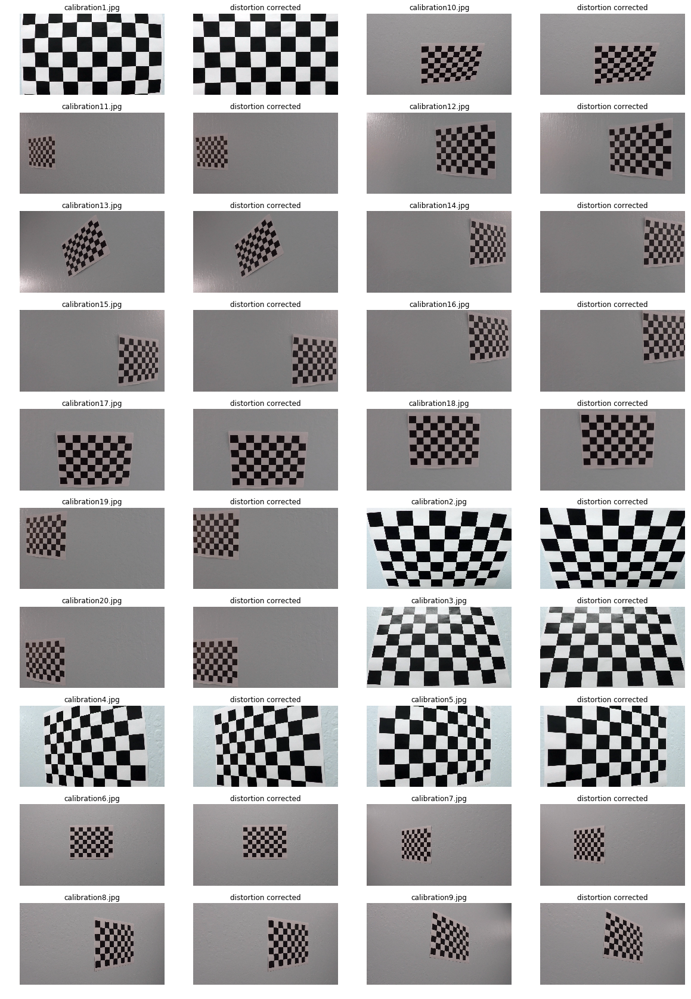

In [8]:
# apply undistortion and display distortion corrected images
tryCalibrationImages(undistort, 'distortion corrected')

## 2. Pipeline (test images)

In [9]:
# loop through test images, apply transform and display output
def showImage(ax, img, label, file, color = 'color'):
    ax.axis('off')
    
    if color == 'color':
        ax.imshow(img)
    else:
        ax.imshow(img, cmap='gray')
    
    if label == None:
        ax.set_title(file, fontsize = 24)
    else:
        ax.set_title(label, fontsize = 24)
    
def tryTestImages(func1, label1 = None, func2 = None, label2 = None, func3 = None, label3 = None, func4 = None, label4 = None, color = 'color'):
    fg, ax = plt.subplots(len(os.listdir('test_images/')), 4, figsize=(40, 50))
    ax = ax.ravel()
    i = 0

    for file in os.listdir('test_images/'):
        # read image from file
        img = cv2.imread('test_images/'+file)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
                    
        img1 = func1(img)
        showImage(ax[i], img1, label1, file)

        if func2 != None:
            img2 = func2(img1)
            showImage(ax[i+1], img2, label2, file, color)
            
            if func3 != None:
                img3 = func3(img1)
                showImage(ax[i+2], img3, label3, file, color)
            
                if func4 != None:
                    img4 = func4(img1)
                    showImage(ax[i+3], img4, label4, file, color)

        ax[i+1].axis('off')
        ax[i+2].axis('off')
        ax[i+3].axis('off')
        i = i + 4
        
def passthru(img):
    return img

### 2.1. Undistort

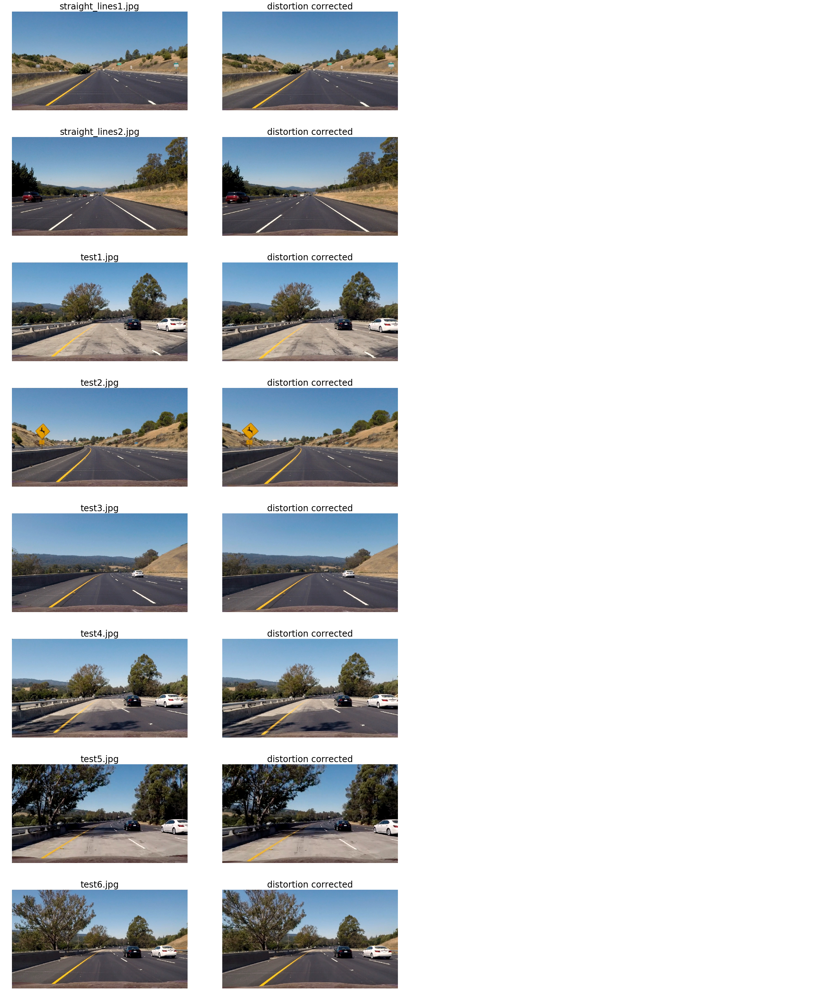

In [10]:
tryTestImages(passthru, None, 
              undistort, 'distortion corrected', 
              color = 'gray')

### 2.2. Color Transforms and Gradients

In [11]:
def abs_sobel_thresh(gray, kernel, orient, thresh_min, thresh_max):
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=kernel)) # y_orient
    else:
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=kernel)) # x_orient
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Return the result
    return binary_output

In [12]:
def apply_sobelx(img):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    blur = cv2.GaussianBlur(gray, (15, 15), 0)

    return abs_sobel_thresh(blur, 15, 'x', 60, 140)

def apply_sobely(img):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    blur = cv2.GaussianBlur(gray, (15, 15), 0)

    return abs_sobel_thresh(blur, 15, 'y', 50, 150)

def sobel_xy(img):
    sobelx = apply_sobelx(img)
    sobely = apply_sobely(img)
    
    sobelxy = np.zeros_like(sobelx)
    sobelxy[(sobelx == 1) | (sobely == 1)] = 1

    return sobelxy

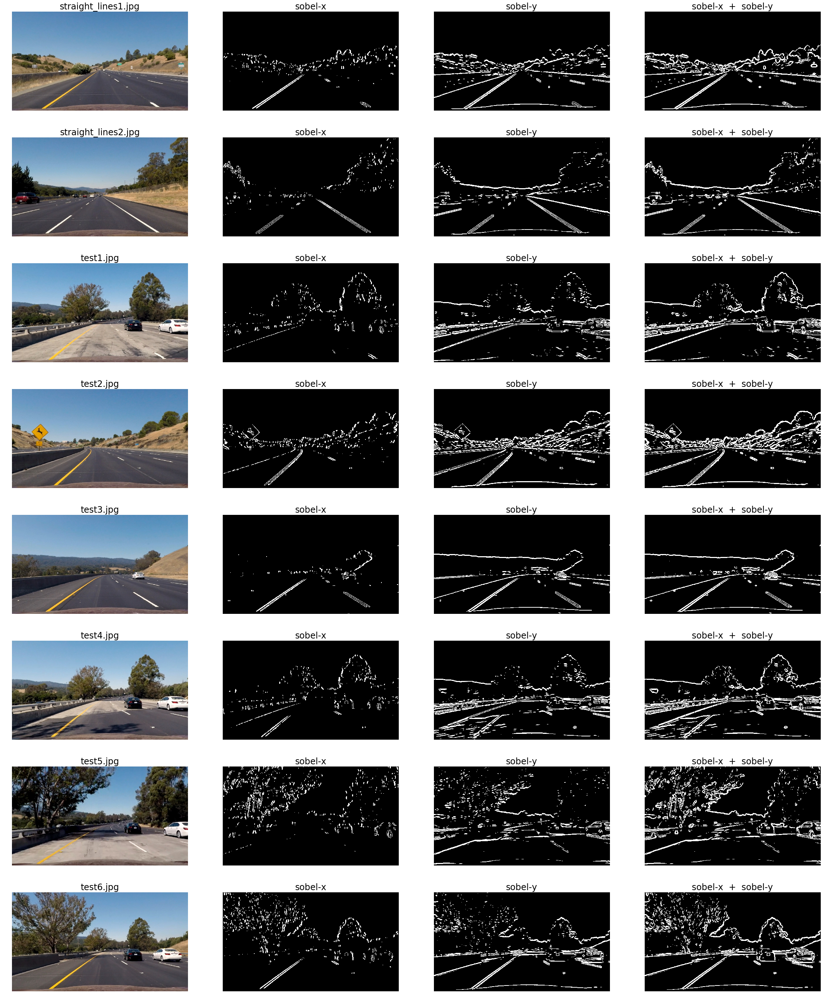

In [13]:
tryTestImages(undistort, None, 
              apply_sobelx, 'sobel-x', 
              apply_sobely, 'sobel-y', 
              sobel_xy, 'sobel-x  +  sobel-y', 
              color = 'gray')

In [14]:
def mag_thresh(img, kernel, mag_thresh):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    blur = cv2.GaussianBlur(gray, (kernel, kernel), 0)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output

def apply_mag_thresh(img):
    return mag_thresh(img, 15, (60, 140))

In [15]:
def dir_thresh(img, sobel_kernel, thresh):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output

def apply_dir_thresh(img):
    return dir_thresh(img, 15, (0.7, 1.3))

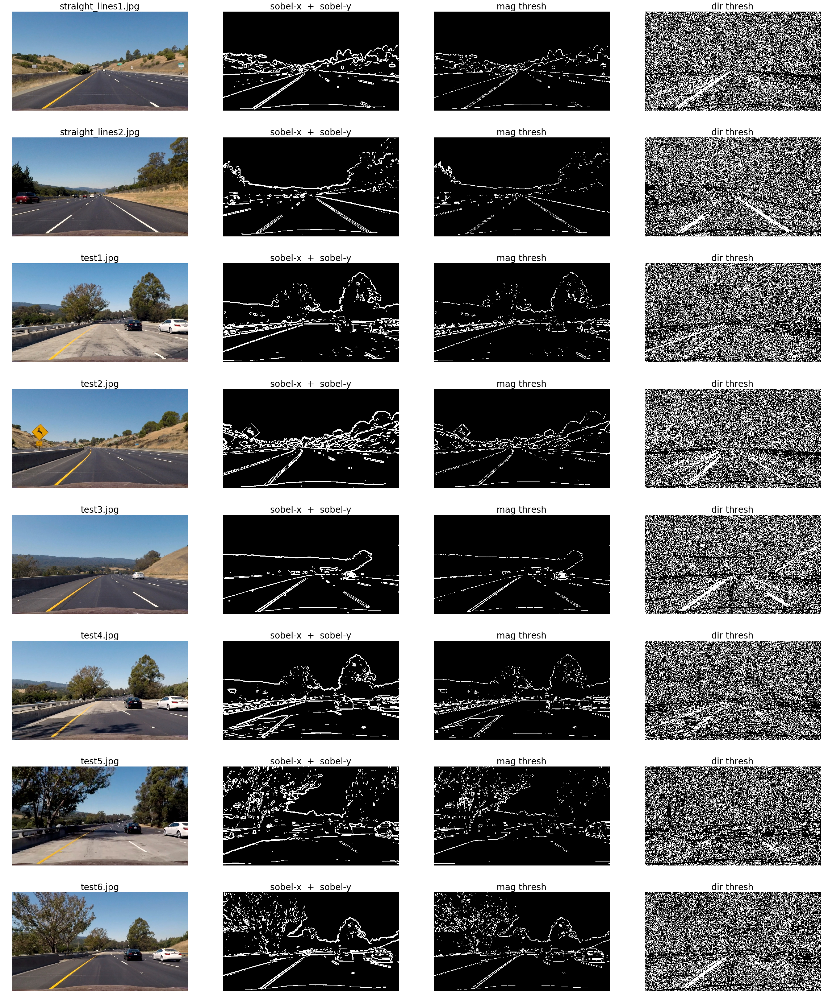

In [16]:
tryTestImages(undistort, None, 
              sobel_xy, 'sobel-x  +  sobel-y', 
              apply_mag_thresh, 'mag thresh', 
              apply_dir_thresh, 'dir thresh', 
              color = 'gray')

In [17]:
def hls_split(img, channel):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    if channel == 'h':
        hls_channel = hls[:,:,0] # h_channel
    elif channel == 'l':
        hls_channel = hls[:,:,1] # l_channel
    else:
        hls_channel = hls[:,:,2] # s_channel
        
    return hls_channel

In [18]:
def get_HLS_H(img):
    return hls_split(img, 'h')

def get_HLS_L(img):
    return hls_split(img, 'l')

def get_HLS_S(img):
    return hls_split(img, 's')

In [19]:
def hsv_split(img, channel):
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    if channel == 'h':
        hsv_channel = hsv[:,:,0] # h_channel
    elif channel == 's':
        hsv_channel = hsv[:,:,1] # s_channel
    else:
        hsv_channel = hsv[:,:,2] # v_channel
        
    return hsv_channel

In [20]:
def get_HSV_H(img):
    return hsv_split(img, 'h')

def get_HSV_S(img):
    return hsv_split(img, 's')

def get_HSV_V(img):
    return hsv_split(img, 'v')

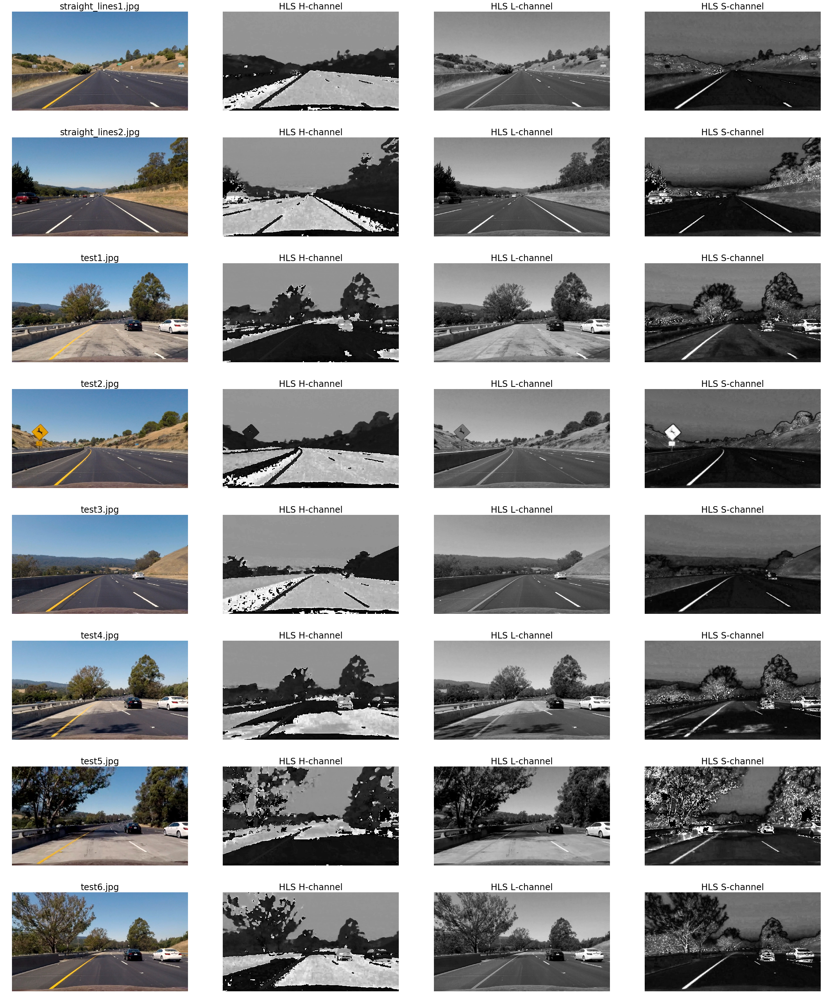

In [21]:
tryTestImages(undistort, None, 
              get_HLS_H, 'HLS H-channel', 
              get_HLS_L, 'HLS L-channel', 
              get_HLS_S, 'HLS S-channel', 
              color = 'gray')

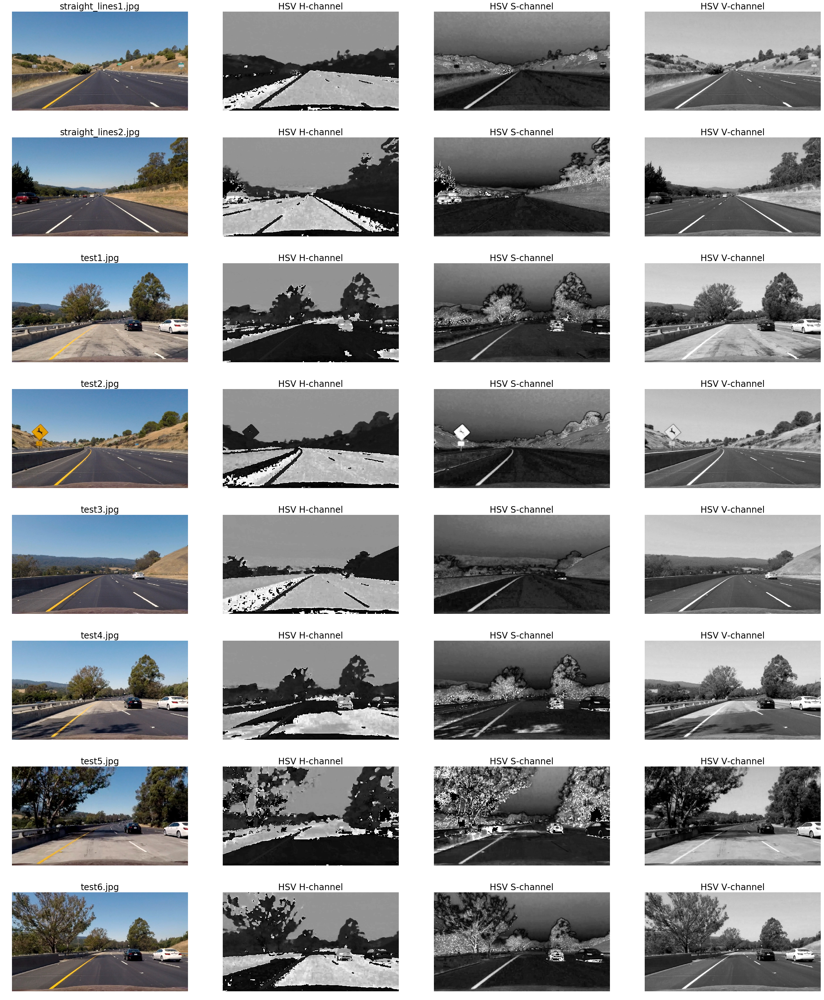

In [22]:
tryTestImages(undistort, None, 
              get_HSV_H, 'HSV H-channel', 
              get_HSV_S, 'HSV S-channel', 
              get_HSV_V, 'HSV V-channel', 
              color = 'gray')

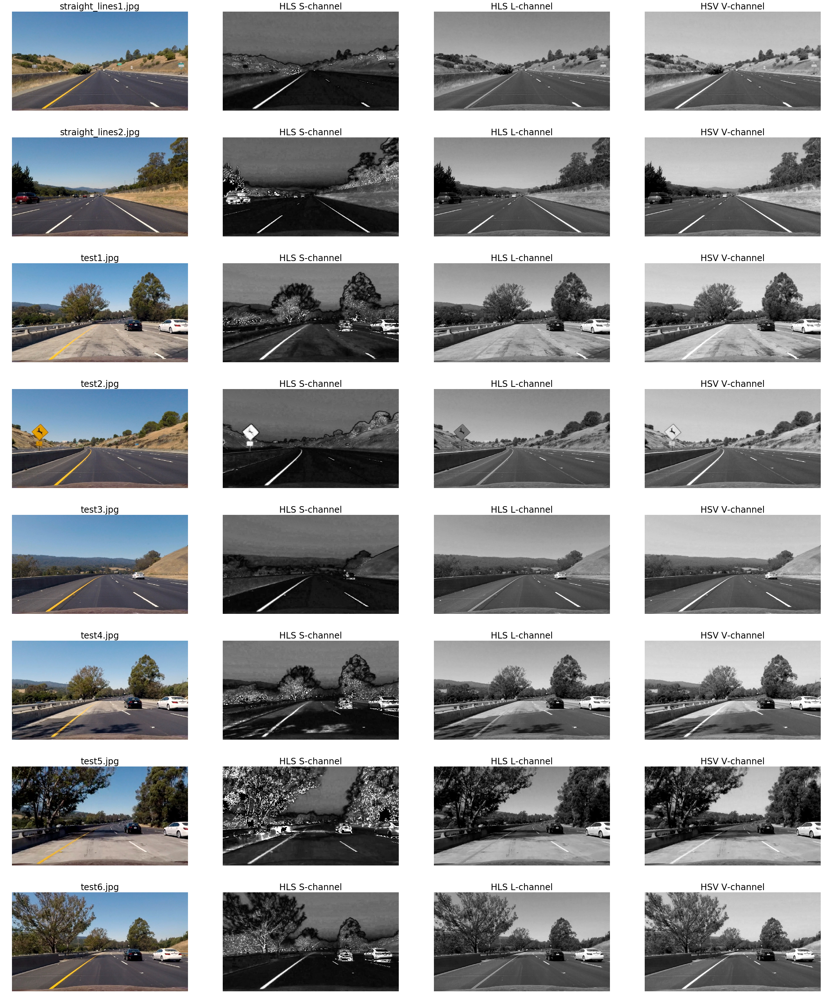

In [23]:
tryTestImages(undistort, None, 
              get_HLS_S, 'HLS S-channel', 
              get_HLS_L, 'HLS L-channel', 
              get_HSV_V, 'HSV V-channel', 
              color = 'gray')

In [24]:
def hls_select(img, channel, thresh):
    hls = hls_split(img, channel)
    
    binary_output = np.zeros_like(hls)
    binary_output[(hls > thresh[0]) & (hls <= thresh[1])] = 1

    return binary_output

In [25]:
def thresh_HLS_H(img):
    return hls_select(img, 'h', (18, 42))

def thresh_HLS_L(img):
    return hls_select(img, 'l', (200, 255))

def thresh_HLS_S(img):
    return hls_select(img, 's', (160, 240))

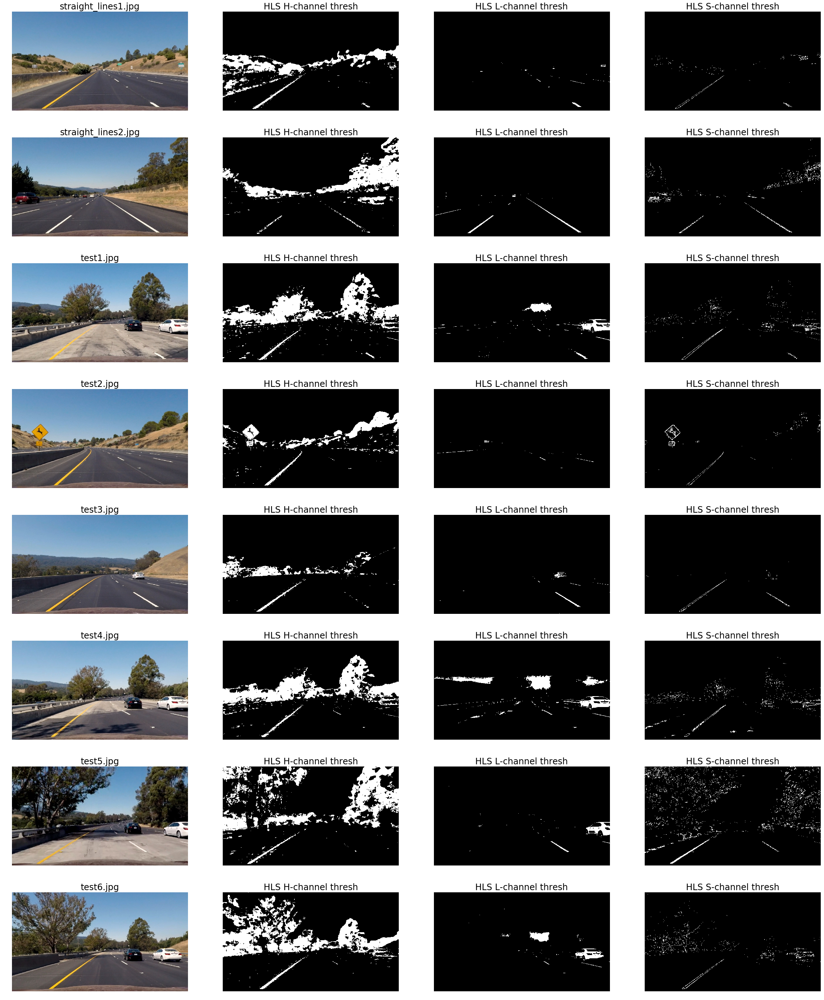

In [26]:
tryTestImages(undistort, None, 
              thresh_HLS_H, 'HLS H-channel thresh', 
              thresh_HLS_L, 'HLS L-channel thresh', 
              thresh_HLS_S, 'HLS S-channel thresh', 
              color = 'gray')

In [27]:
def hsv_select(img, channel, thresh):
    hsv = hsv_split(img, channel)
    
    binary_output = np.zeros_like(hsv)
    binary_output[(hsv > thresh[0]) & (hsv <= thresh[1])] = 1

    return binary_output

In [28]:
def thresh_HSV_H(img):
    return hsv_select(img, 'h', (18, 42))

def thresh_HSV_V(img):
    return hsv_select(img, 'v', (220, 255))

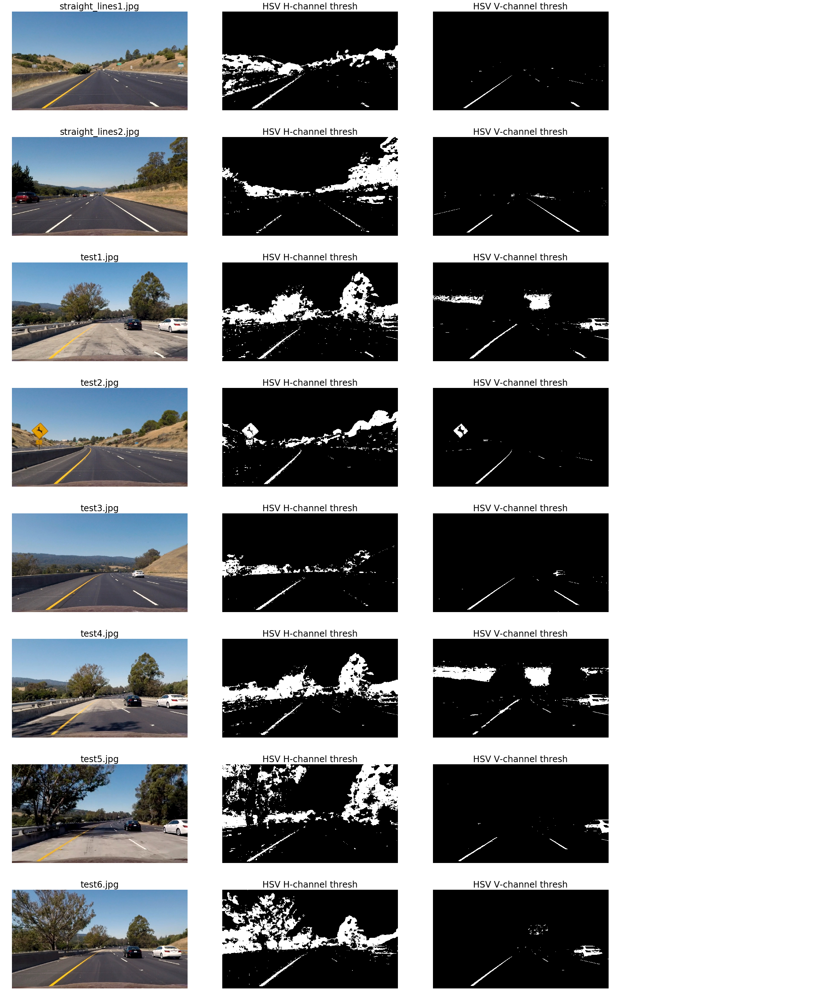

In [29]:
tryTestImages(undistort, None, 
              thresh_HSV_H, 'HSV H-channel thresh', 
              thresh_HSV_V, 'HSV V-channel thresh', 
              color = 'gray')

In [30]:
def get_HLS_L_sobelx(img):
    hls = hls_split(img, 'l')
    sobelx = abs_sobel_thresh(hls, 5, 'x', 40, 120)
    
    kernel = np.ones((3, 3),np.uint8)
    out = cv2.dilate(sobelx, kernel, iterations = 1)

    return sobelx

In [31]:
def processImage_stacked(img):
    hsv = thresh_HSV_V(img) 
    sobel = get_HLS_L_sobelx(img) 

    combined = np.dstack((hsv, sobel, np.zeros_like(hsv))) * 255
    
    return combined

In [32]:
# FINAL
def processImage(img):
    hsv = thresh_HSV_V(img) 
    sobel = get_HLS_L_sobelx(img) 

    combined = np.zeros_like(hsv)
    combined[(hsv == 1) | (sobel == 1)] = 1
    
    return combined

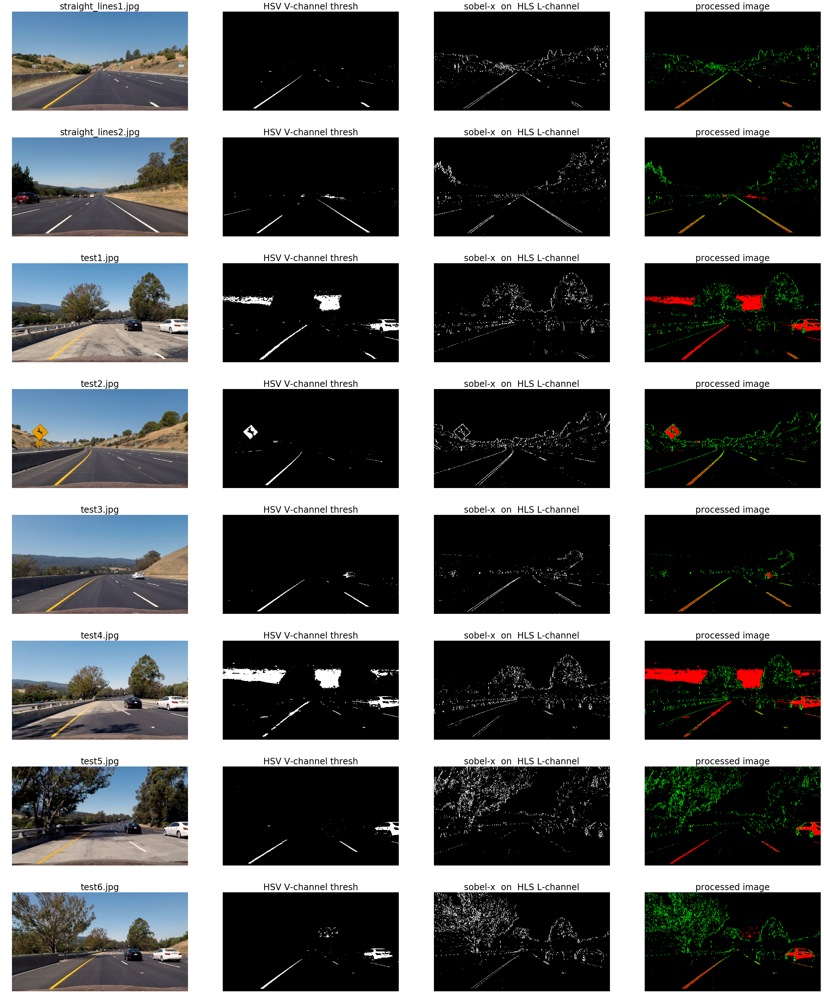

In [33]:
# FINAL
tryTestImages(undistort, None, 
              thresh_HSV_V, 'HSV V-channel thresh', 
              get_HLS_L_sobelx, 'sobel-x  on  HLS L-channel', 
              processImage_stacked, 'processed image', 
              color = 'gray')

### 2.3. Perspective Transform

In [34]:
def getWarp(img):
    shape = img.shape[1::-1]
        
    src_pts = np.array([[  268,   700], 
                        [  589,   457], 
                        [  698,   457], 
                        [ 1065,   700]])
    dst_pts = np.array([[  320,   720], 
                        [  320,     0], 
                        [  980,     0], 
                        [  980,   720]])
    
    src = np.float32(src_pts)
    dst = np.float32(dst_pts)

    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, shape)    
    
    return warped, Minv

In [35]:
def apply_warp(img):
    processed = processImage(img)
    warped, Minv = getWarp(processed)
    
    return warped

In [36]:
def apply_warp_dilated(img):
    processed = processImage(img)
    warped, Minv = getWarp(processed)
    
    kernel = np.ones((3, 3),np.uint8)
    dilated = cv2.dilate(warped, kernel, iterations = 1)

    return dilated

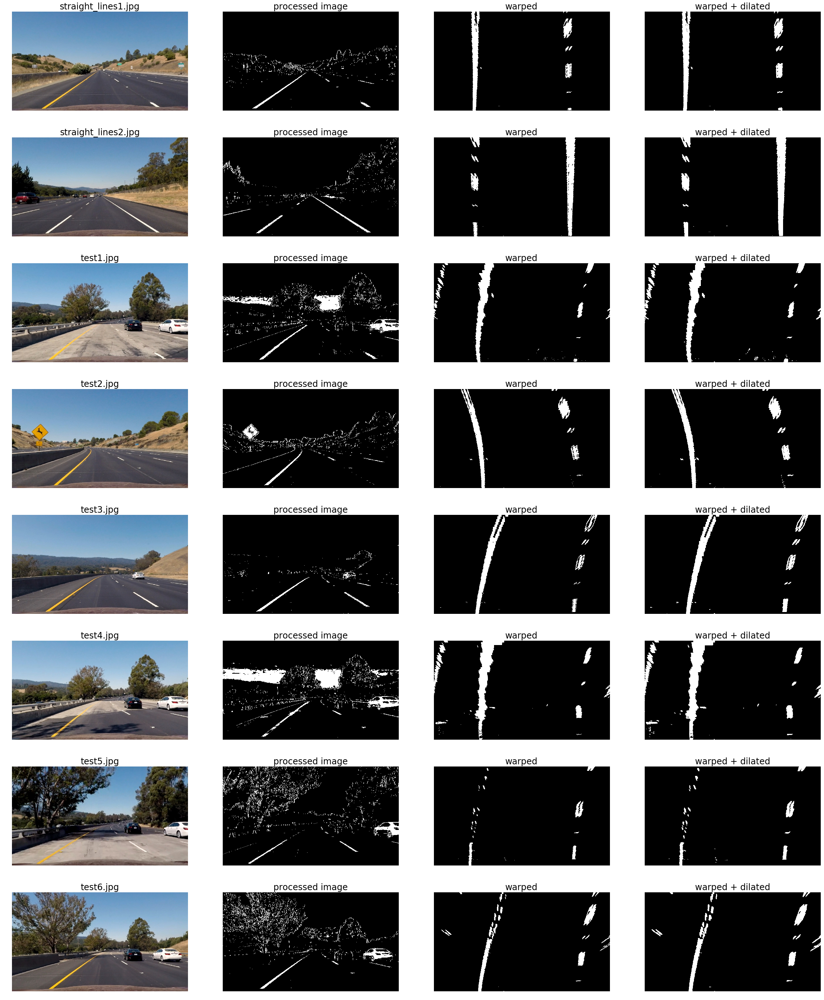

In [37]:
# FINAL
tryTestImages(undistort, None, 
              processImage, 'processed image', 
              apply_warp, 'warped', 
              apply_warp_dilated, 'warped + dilated', 
              color = 'gray')

### 2.4. Find Lane-Line Pixels

**Find Pixels using Sliding Window**

In [38]:
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 80
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        ## Visualization ##
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        ## End visualization steps ##
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img


def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    # Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='yellow')
    left_pts = np.vstack((left_fitx, ploty)).astype(np.int32).T
    right_pts = np.vstack((right_fitx, ploty)).astype(np.int32).T
    cv2.polylines(out_img,  [left_pts],  False,  (255, 255, 0),  10)
    cv2.polylines(out_img,  [right_pts],  False,  (255, 255, 0),  10)
    
    color_warp = get_color_warp(binary_warped, left_fitx, right_fitx, ploty)
    
    radius, center_dist = measure_curvature_drift(binary_warped, left_fitx, right_fitx, ploty)

    return left_fit, right_fit, out_img, color_warp, radius, center_dist

**Search around Previous Polynomial Fit Values**

In [39]:
# Polynomial fit values from the previous frame
# Make sure to grab the actual values from the previous step in your project!
#left_fit = np.array([ 2.13935315e-04, -3.77507980e-01,  4.76902175e+02])
#right_fit = np.array([4.17622148e-04, -4.93848953e-01,  1.11806170e+03])

def fit_poly(img_shape, leftx, lefty, rightx, righty):
     ### Fit a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    ### Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return left_fit, right_fit, left_fitx, right_fitx, ploty

def search_around_poly(binary_warped, left_fit, right_fit):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 80

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fit_new, right_fit_new, left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='yellow')
    left_pts = np.vstack((left_fitx, ploty)).astype(np.int32).T
    right_pts = np.vstack((right_fitx, ploty)).astype(np.int32).T
    cv2.polylines(result,  [left_pts],  False,  (255, 255, 0),  10)
    cv2.polylines(result,  [right_pts],  False,  (255, 255, 0),  10)
    ## End visualization steps ##
    
    color_warp = get_color_warp(binary_warped, left_fitx, right_fitx, ploty)
    
    radius, center_dist = measure_curvature_drift(binary_warped, left_fitx, right_fitx, ploty)
    
    return left_fit_new, right_fit_new, result, color_warp, radius, center_dist

### 2.5. Calculate Radius of Curvature and Vehicle Position

In [40]:
def measure_curvature_drift(warped, leftx, rightx, ploty):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/660 # meters per pixel in x dimension
    
    # Fit a second order polynomial to pixel positions in each fake lane line
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
    
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    radius = ((left_curverad + right_curverad) / 2)
    
    car_pos = warped.shape[1] / 2
    lane_pos = (leftx[-1] + rightx[-1]) / 2
    center_dist = (car_pos * xm_per_pix) - (lane_pos * xm_per_pix)

    return radius, center_dist

### 2.6. Identify Lane Area

In [41]:
def get_color_warp(warped, left_fitx, right_fitx, ploty):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    return color_warp

### 2.7. Display Results

In [42]:
def apply_sliding_window(img):
    warped = apply_warp_dilated(img)
    left_fit, right_fit, output, color_warp, radius, center_dist = fit_polynomial(warped)
    return output

In [43]:
def apply_search_around_poly(img):
    warped = apply_warp_dilated(img)
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(warped)
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    left_fit_new, right_fit_new, output, color_warp, radius, center_dist = search_around_poly(warped, left_fit, right_fit)
    return output

In [44]:
def test_pipeline(undist):
    processed = processImage(undist)
    warped, Minv = getWarp(processed)
    
    kernel = np.ones((3, 3),np.uint8)
    dilated = cv2.dilate(warped, kernel, iterations = 1)

    left_fit, right_fit, output, color_warp, radius, center_dist = fit_polynomial(warped)
        
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (undist.shape[1], undist.shape[0])) 
    # Combine the result with the original image

    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    #plt.imshow(result)
    
    if radius > 2000:
        text = 'Radius: Straight Road'
    else:
        text = 'Radius: ' + '{:04.2f}'.format(radius) + 'm'
    cv2.putText(result, text, (40,70), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), 2, cv2.LINE_AA)
    
    if center_dist > 0:
        text = 'Vehicle is ' + '{:04.2f}'.format(center_dist) + 'm on right'
    else:
        text = 'Vehicle is ' + '{:04.2f}'.format(abs(center_dist)) + 'm on left'
    cv2.putText(result, text, (40,120), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), 2, cv2.LINE_AA)

    return result

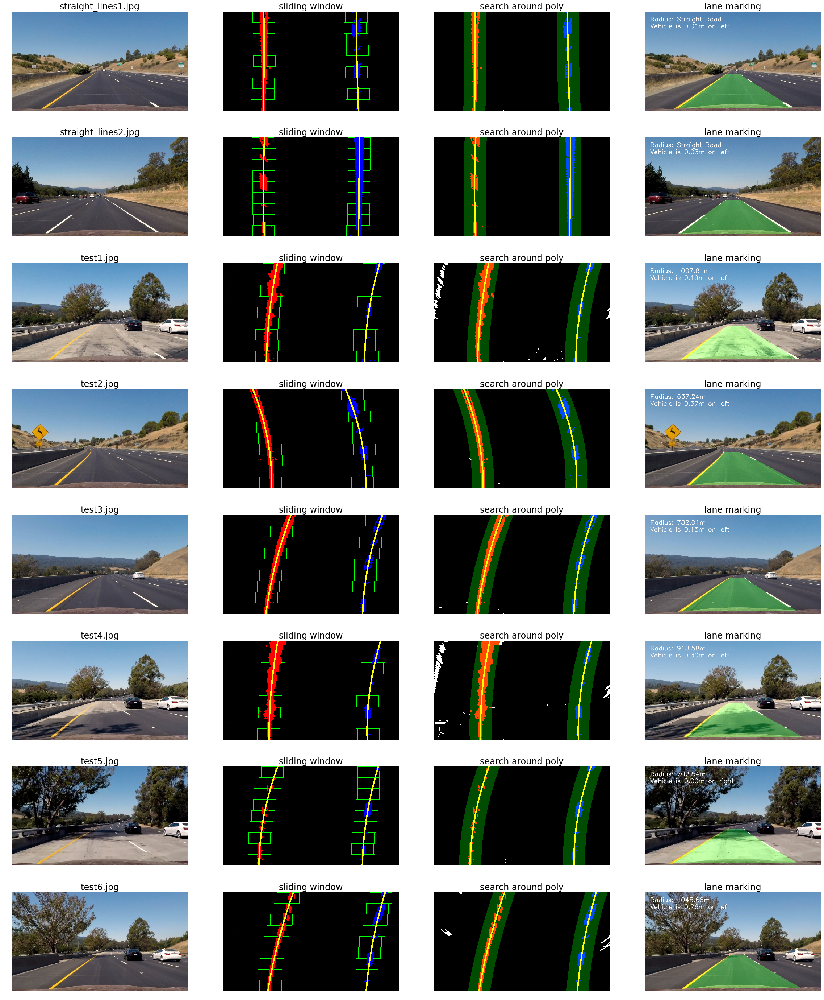

In [45]:
# FINAL
tryTestImages(undistort, None, 
              apply_sliding_window, 'sliding window', 
              apply_search_around_poly, 'search around poly', 
              test_pipeline, 'lane marking', 
              color = 'color')

## 3. Pipeline (video)

In [46]:
left_fit = None
right_fit = None

def video_pipeline(img):
    global left_fit
    global right_fit
    
    undist = undistort(img)
    
    processed = processImage(undist)
    warped, Minv = getWarp(processed)
    
    kernel = np.ones((3, 3),np.uint8)
    dilated = cv2.dilate(warped, kernel, iterations = 1)

    if left_fit == None or right_fit == None:
        left_fit, right_fit, output, color_warp, radius, center_dist = fit_polynomial(warped)
    else:
        left_fit, right_fit, output, color_warp, radius, center_dist = search_around_poly(warped, left_fit, right_fit)
        
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0])) 
    # Combine the result with the original image

    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    #plt.imshow(result)
    
    if radius > 2000:
        text = 'Radius: Straight Road'
    else:
        text = 'Radius: ' + '{:04.2f}'.format(radius) + 'm'
    cv2.putText(result, text, (40,70), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), 2, cv2.LINE_AA)
    
    if center_dist > 0:
        text = 'Vehicle is ' + '{:04.2f}'.format(center_dist) + 'm on right'
    else:
        text = 'Vehicle is ' + '{:04.2f}'.format(abs(center_dist)) + 'm on left'
    cv2.putText(result, text, (40,120), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255,255,255), 2, cv2.LINE_AA)

    return result

In [47]:
left_fit = None
right_fit = None

from moviepy.editor import VideoFileClip
from IPython.display import HTML

challenge_output = 'output_video.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip3 = VideoFileClip('test_videos/challenge.mp4').subclip(0,5)
clip3 = VideoFileClip('project_video.mp4')
challenge_clip = clip3.fl_image(video_pipeline)
%time challenge_clip.write_videofile(challenge_output, audio=False)

[MoviePy] >>>> Building video output_video.mp4
[MoviePy] Writing video output_video.mp4


100%|█████████████████████████████████████▉| 1260/1261 [02:44<00:00,  7.67it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: output_video.mp4 

Wall time: 2min 45s


In [48]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(challenge_output))